In [2]:
using Plots
using CSV
using DataFrames
using Glob
using JLD2
using ProgressMeter
using Printf

using GalaxySim

In [3]:
fpath = "static_eq/"
skip = 1

function get_col(col)
    file = fpath * col * ".dat"
    df = Array(CSV.read(file, DataFrame, header=false)[1:skip:end, 1:end-1])
    return df
end

get_col (generic function with 1 method)

In [4]:
x1s = get_col("x1")
x2s = get_col("x2")
x3s = get_col("x3")
v1s = get_col("v1")
v2s = get_col("v2")
v3s = get_col("v3")


ρs = get_col("rho")
Ts = get_col("T")
ts = get_col("t")

hs = get_col("h")
dts = get_col("dt")
Nn = get_col("N_neighbors")

Rs = @. sqrt(x1s^2 + x2s^2 + x3s^2)
Vs = @. sqrt(v1s^2 + v2s^2 + v3s^2)

400×500 Matrix{Float64}:
 1.81712  1.81712  1.81712  1.81712   …  1.81712  1.81712  1.81712  1.81712
 1.81706  1.81707  1.81711  1.81377      1.81784  1.81664  1.8152   1.81741
 1.81699  1.81703  1.8171   1.81025      1.81863  1.81612  1.81322  1.8177
 1.81692  1.81698  1.81709  1.80673      1.81946  1.8156   1.81126  1.81801
 1.81686  1.81693  1.81708  1.80321      1.82033  1.81507  1.80933  1.81832
 1.81679  1.81688  1.81707  1.79972   …  1.82124  1.81453  1.8074   1.81864
 1.81672  1.81684  1.81706  1.79625      1.8222   1.81399  1.80549  1.81898
 1.81666  1.81679  1.81705  1.79282      1.82319  1.81343  1.80359  1.81934
 1.8166   1.81674  1.81704  1.78944      1.82422  1.81287  1.80169  1.81972
 1.81653  1.81669  1.81703  1.78613      1.82528  1.8123   1.79979  1.82011
 1.81647  1.81665  1.81702  1.78297   …  1.82634  1.81172  1.79784  1.82051
 1.81641  1.8166   1.81701  1.77994      1.82738  1.81113  1.79582  1.82092
 1.81634  1.81655  1.817    1.777        1.82835  1.81054  1.793

Progress: 100%|█████████████████████████████████████████| Time: 0:00:21
[ Info: Saved animation to /home/daniel/.julia/dev/GalaxySim/tmp.gif


Plots.AnimatedGif("/home/daniel/.julia/dev/GalaxySim/tmp.gif")
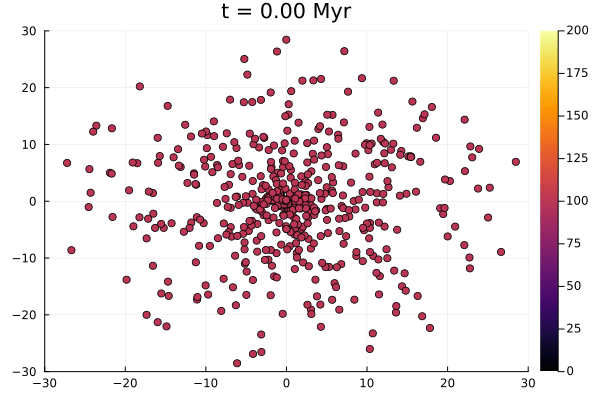

In [5]:
Nt, N = size(x1s)
prog = Progress(Nt)


Rv = 30

function plot_gal(x, y, c, s, t)    
    scatter(x, y, marker_z=c, clim=(0, 200), xlim=[-Rv, Rv], ylim=[-Rv, Rv], legend=false, colorbar=true)
    title!(@sprintf("t = %2.2f Myr", t/1e6))  
end


@gif for i ∈ 1:1:Nt
    filt = x1s[i, :] .< Rv
    plot_gal(x1s[i, filt], x2s[i, filt], Ts[i, filt], Rv, ts[i, 1])
    next!(prog)
end

In [6]:
plot(hs)
ylims!(0, 30)

In [7]:
maximum(a for a in Vs)

55.4925150397156

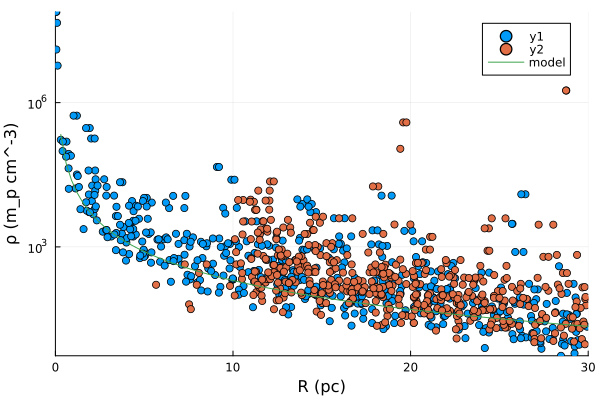

In [12]:
i = 2

scatter(vec(Rs[i, :]), vec(ρs[i,:]), yaxis=:log)
ylims!(minimum(ρs[i,:]), maximum(ρs[i, :]))

i=Nt

scatter!(vec(Rs[i, :]), vec(ρs[i,:]), yaxis=:log)


x_model = LinRange(0, 30., 100)
y_model = 20000 * x_model .^ -2

plot!(x_model, y_model, label="model")
ylabel!("ρ (m_p cm^-3)")
xlabel!("R (pc)")
xlims!(0, 30)

In [13]:
plot(ts/1e6)

In [14]:
plot(Nn)

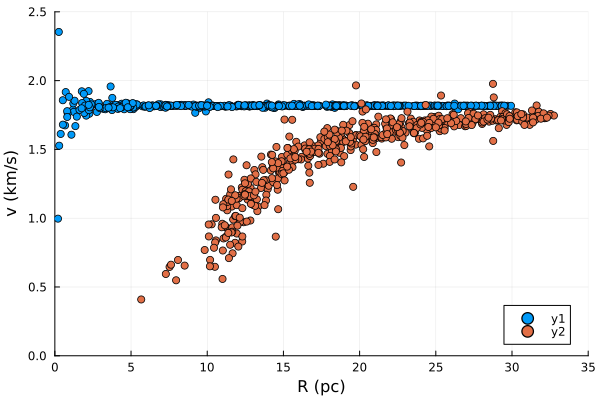

In [22]:
i = 10

scatter(vec(Rs[i, :]), vec(Vs[i,:]))


i=Nt

scatter!(vec(Rs[i, :]), vec(Vs[i,:]))

ylabel!("v (km/s)")
xlabel!("R (pc)")
ylims!(0, 2.5)
xlims!(0, 35)

In [18]:
maximum(dts)

1000.0